# Neural Style Transfer
using OpenCV

**About Neural Style Transfers**

Introduced by Leon Gatys et al. in 2015, in their paper titled “[A Neural Algorithm for Artistic Style](https://arxiv.org/abs/1508.06576)”, the Neural Style Transfer algorithm went viral resulting in an explosion of further work and mobile apps.

Neural Style Transfer enables the artistic style of an image to be applied to another image! It copies the color patterns, combinations, and brush strokes of the original source image and applies it to your input image. And is one the most impressive implementations of Neural Networks in my opinion.

![](https://github.com/rajeevratan84/ModernComputerVision/raw/main/NST.png)

---
### Imports and Helper-functions

In [12]:
import os
from os import listdir
from os.path import isfile, join
import random

import numpy as np
import matplotlib.pyplot as plt
import cv2

In [2]:
def imshow(img, title=None, size=10, axis=False, color_space="BGR"):
    aspect_ratio = img.shape[0] / img.shape[1]
    plt.figure(figsize=(size * aspect_ratio, size))
    if color_space.lower() == "bgr":
        rgb_img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    elif color_space.lower() == "rgb":
        rgb_img = img
    else:
        rgb_img = cv2.cvtColor(img, cv2.COLOR_HSV2RGB)
    plt.imshow(rgb_img)
    if type(title) == str:
        plt.title(title)
    if axis == False:
        plt.axis('off')
    plt.show()

In [4]:
def get_random_img_path(search_path='../../res/img', skip=["flickr"]):
    """
    This function searches for common image files in all subdirectories
    and return a random image path of them.
    """
    image_extensions = ['.jpg', '.jpeg', '.png', '.gif', '.bmp', '.tiff', '.ico']
    image_paths = []

    # Walk through all subdirectories
    for root, dirs, files in os.walk(search_path):
        for file_name in files:
            # Check if the file is an image
            if any(file_name.lower().endswith(ext) for ext in image_extensions):
                # Get the full file path
                full_path = os.path.join(root, file_name).replace("\\", "/")
                if not any(i in full_path for i in skip):
                    image_paths.append(full_path)

    return random.choice(image_paths)

# get an image
IMG_PATH = get_random_img_path(skip=["flickr", "weather", "gem", "Cheetahs", "Lions", "chinese_art", "course_img"])
IMG_PATH   

'../../res/img/self/_DSC1220.jpg'

---
### Loading data

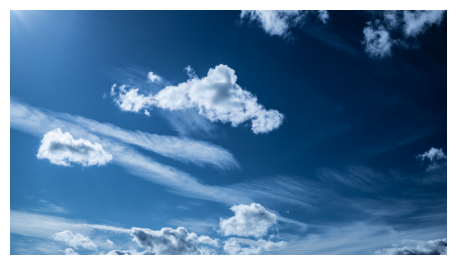

(3376, 6000, 3)

In [6]:
img = cv2.imread(IMG_PATH)
imshow(img)

gray = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)

img.shape

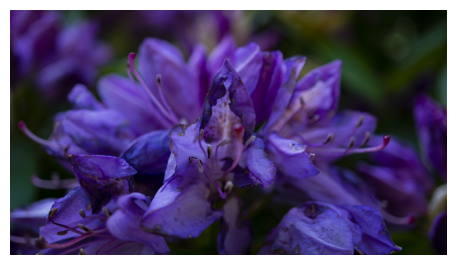

(3376, 6000, 3)

In [61]:
IMG_PATH_2 = get_random_img_path(skip=["flickr", "weather", "gem", "Cheetahs", "Lions", "course_img", "chinese_art"])

img_2 = cv2.imread(IMG_PATH_2)
imshow(img_2)

gray_2 = cv2.cvtColor(img_2, cv2.COLOR_BGR2GRAY)

img_2.shape

---
### Implement Neural Style Transfer using pretrained Models

We use pretrained t7 PyTorch models that can be imported using ``cv2.dnn.readNetFromTouch()```

These models we're using come from the paper *Perceptual Losses for Real-Time Style Transfer and Super-Resolution* by Johnson et al. 

They improved proposing a Neural Style Transfer algorithm that performed 3 times faster by using a super-resolution-like problem based on perceptual loss function.

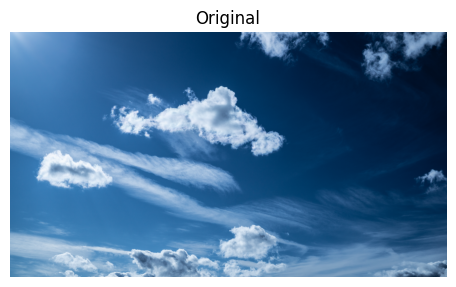

1. Using Model: candy


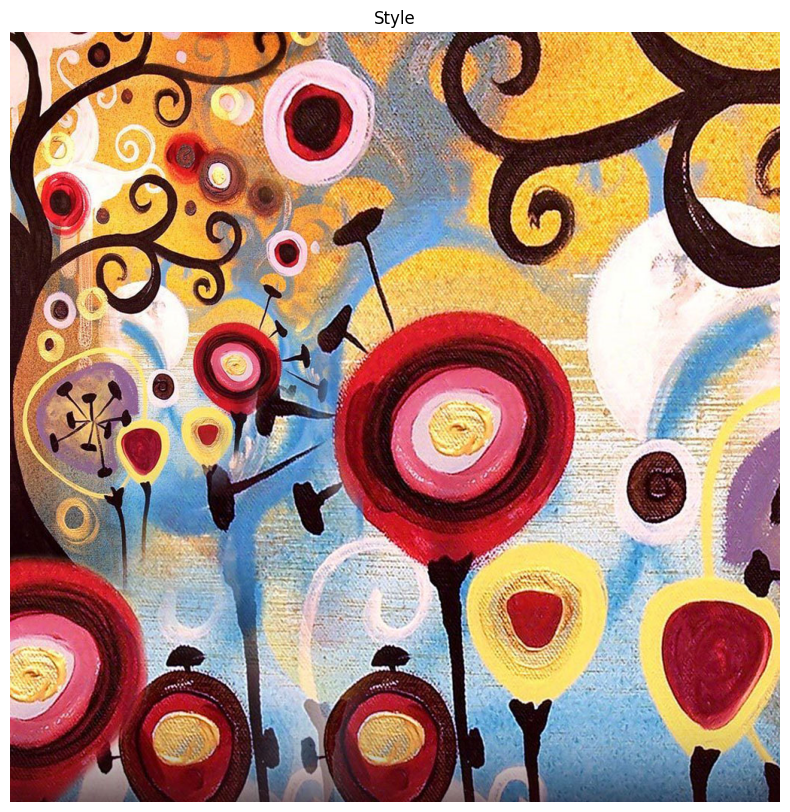

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


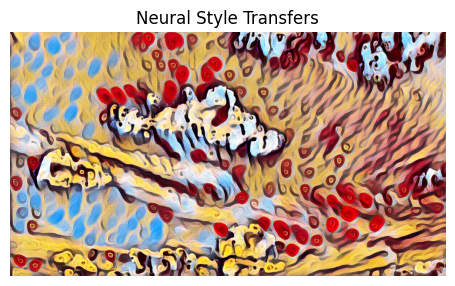

2. Using Model: composition_vii


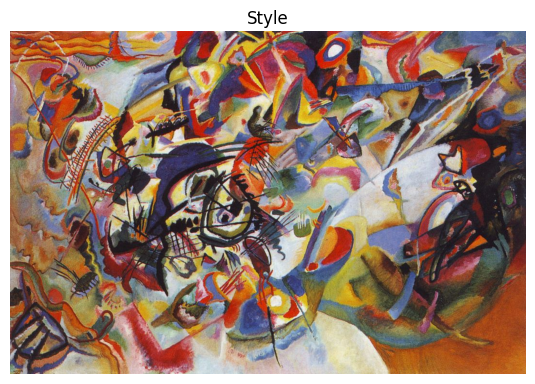

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


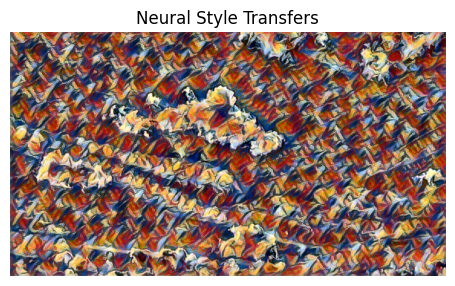

3. Using Model: feathers


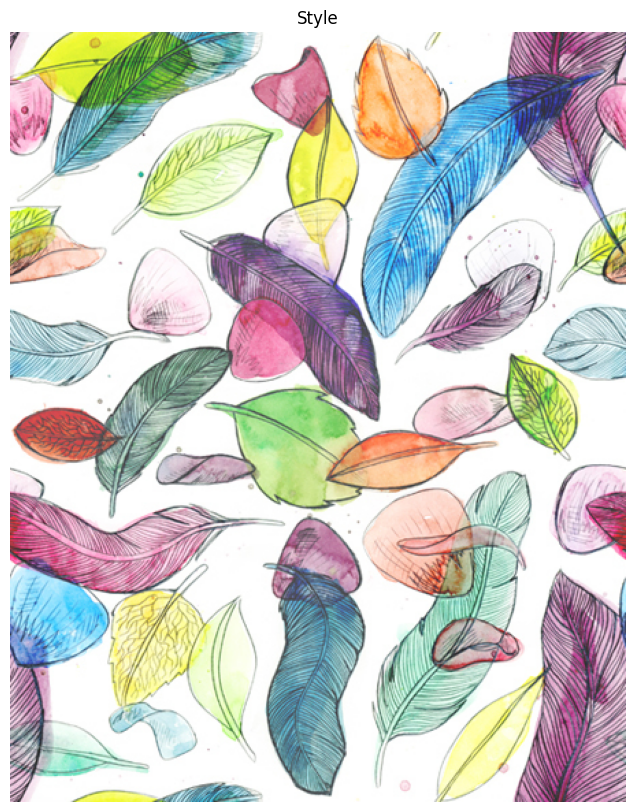

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


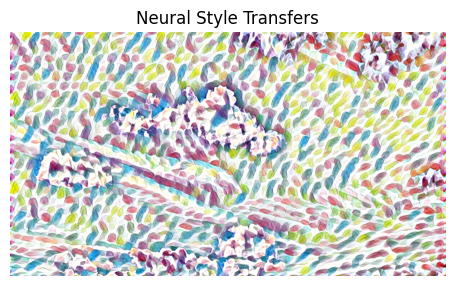

4. Using Model: la_muse


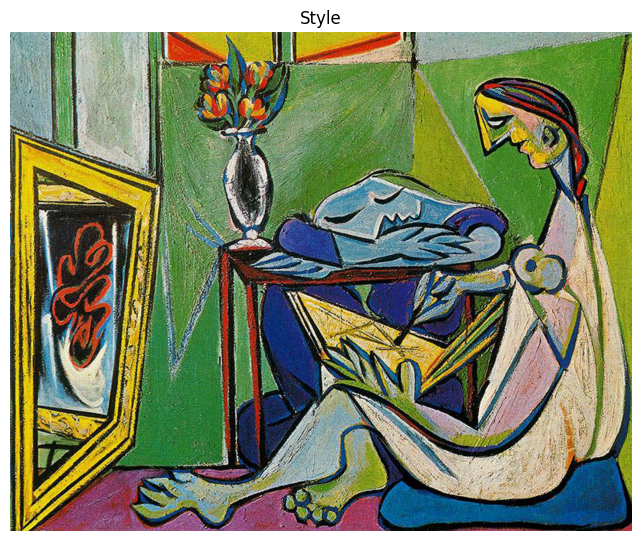

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


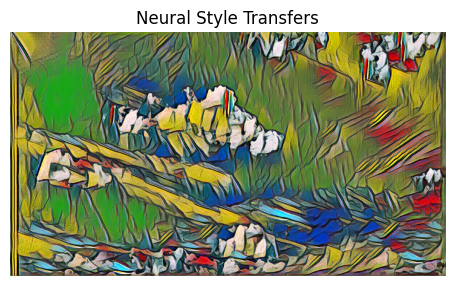

5. Using Model: mosaic


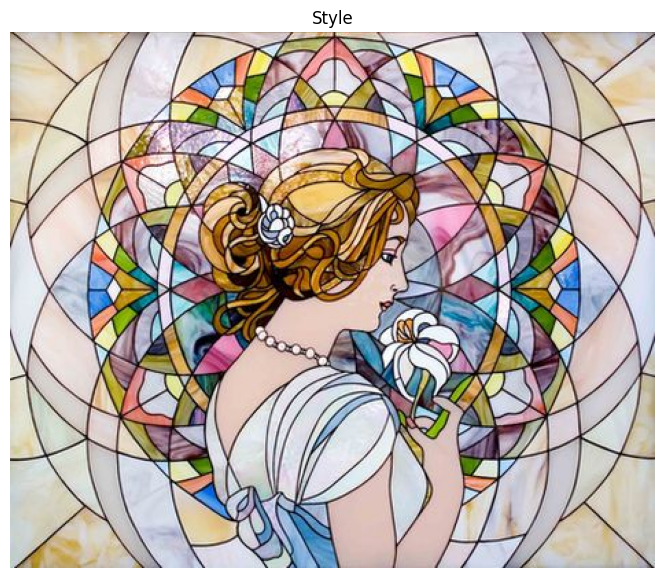

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


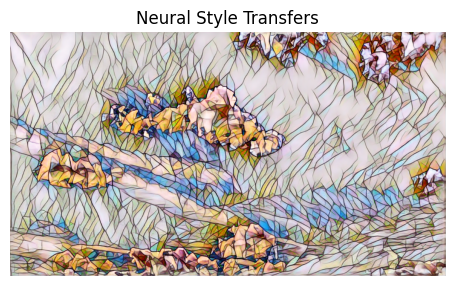

6. Using Model: starry_night


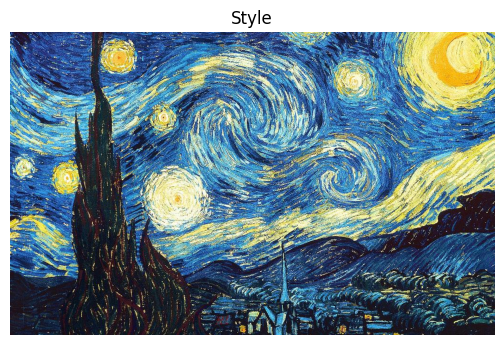

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


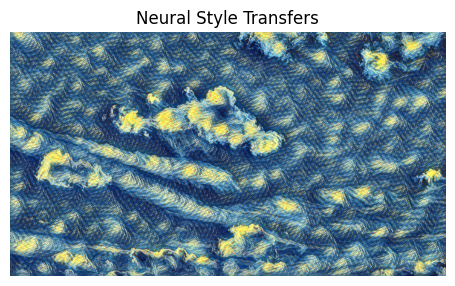

7. Using Model: the_scream


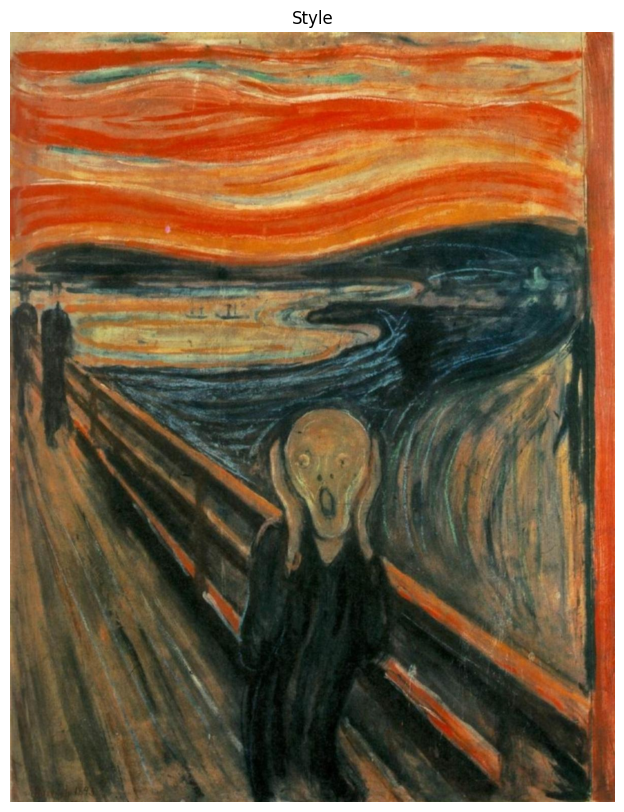

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


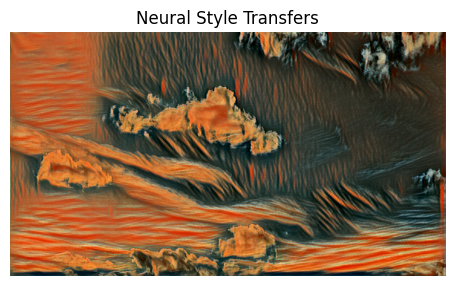

8. Using Model: the_wave


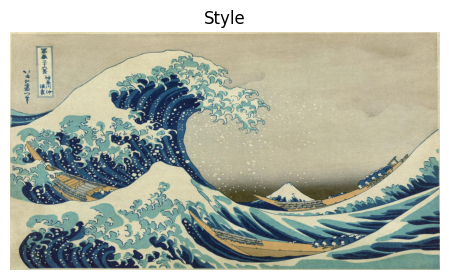

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


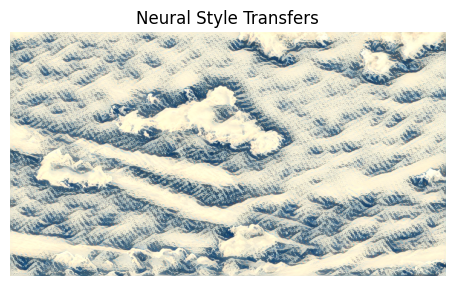

9. Using Model: udnie


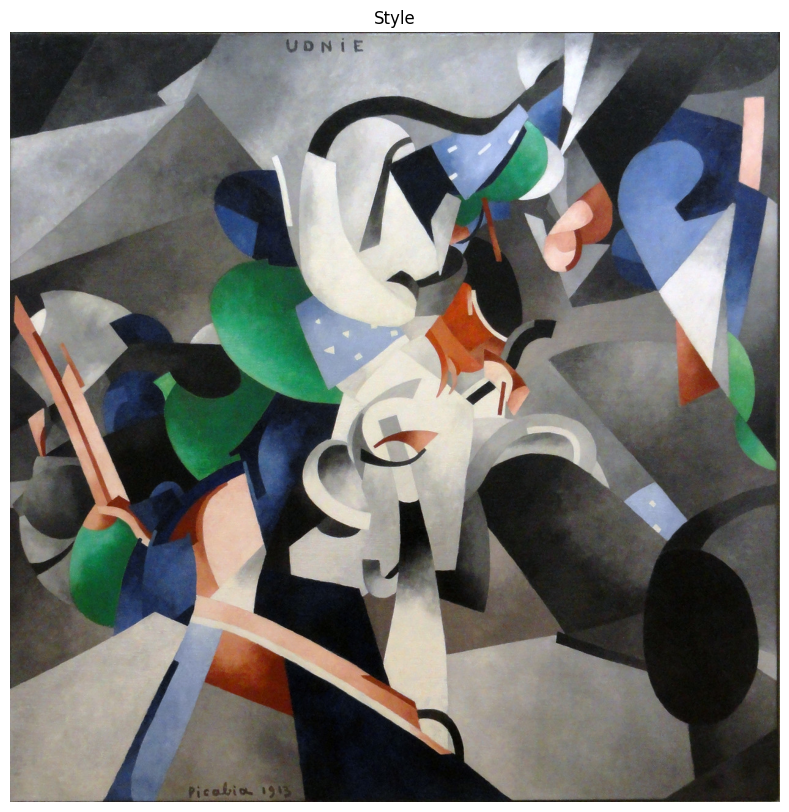

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


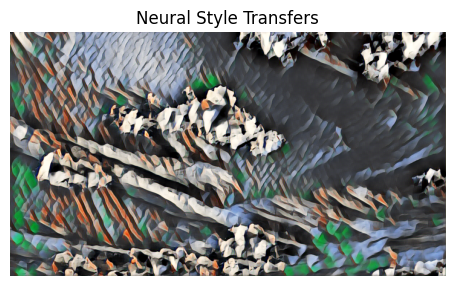

In [19]:
def art_transfer(img):
    imshow(img, "Original")

    # Load our t7 neural transfer models
    model_file_path = "../../res/NeuralStyleTransfer/models/"
    model_file_paths = [f for f in listdir(model_file_path) if isfile(join(model_file_path, f))]

    # Loop through and applying each model style our input image
    for (i,model) in enumerate(model_file_paths):
        # print the model being used
        print(str(i+1) + ". Using Model: " + str(model)[:-3])    
        style = cv2.imread("../../res/NeuralStyleTransfer/art/"+str(model)[:-3]+".jpg")
        # loading our neural style transfer model 
        neuralStyleModel = cv2.dnn.readNetFromTorch(model_file_path+ model)

        # Let's resize to a fixed height of 640 (feel free to change)
        height, width = int(img.shape[0]), int(img.shape[1])
        newWidth = int((640 / height) * width)
        resizedImg = cv2.resize(img, (newWidth, 640), interpolation = cv2.INTER_AREA)

        # Create our blob from the image and then perform a forward pass run of the network
        inpBlob = cv2.dnn.blobFromImage(resizedImg, 1.0, (newWidth, 640), (103.939, 116.779, 123.68), swapRB=False, crop=False)

        neuralStyleModel.setInput(inpBlob)
        output = neuralStyleModel.forward()

        # Reshaping the output tensor, adding back  the mean subtraction and re-ordering the channels 
        output = output.reshape(3, output.shape[2], output.shape[3])
        output[0] += 103.939
        output[1] += 116.779
        output[2] += 123.68
        output /= 255
        output = output.transpose(1, 2, 0)
        
        #Display our original image, the style being applied and the final Neural Style Transfer
        imshow(style, "Style")
        imshow(output, "Neural Style Transfers")

art_transfer(img)

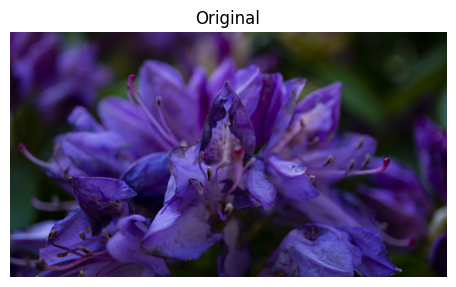

1. Using Model: candy


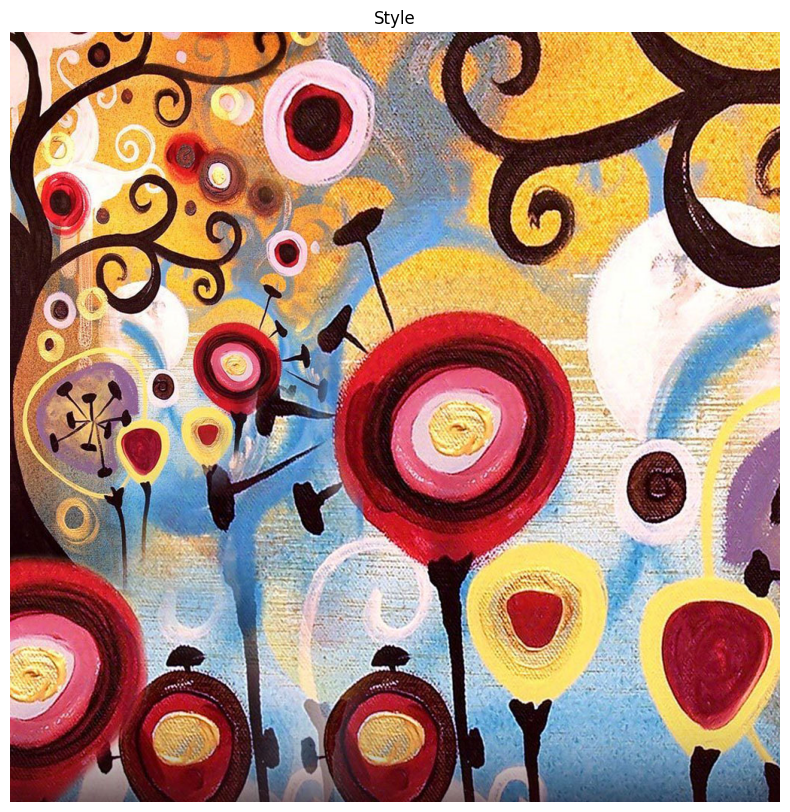

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


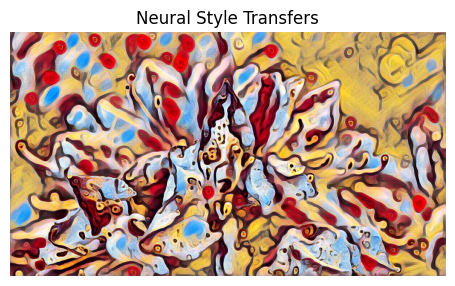

2. Using Model: composition_vii


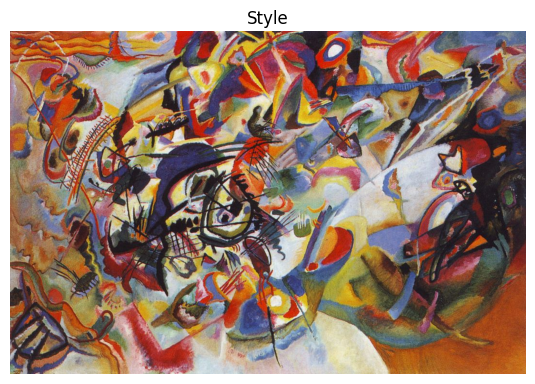

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


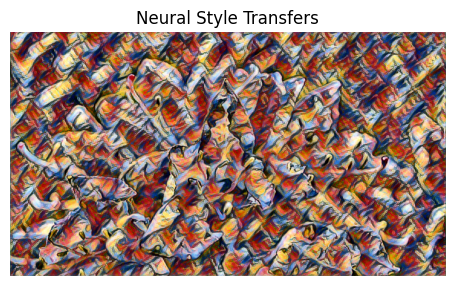

3. Using Model: feathers


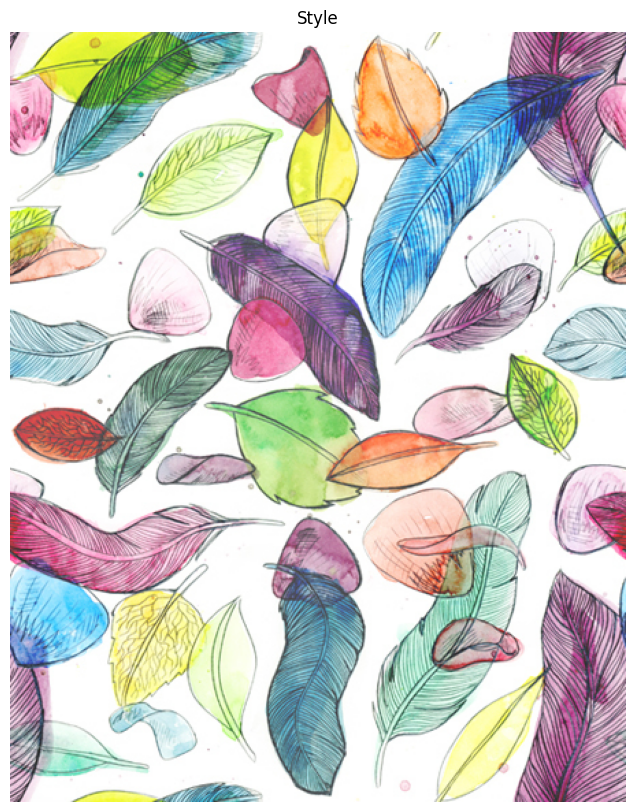

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


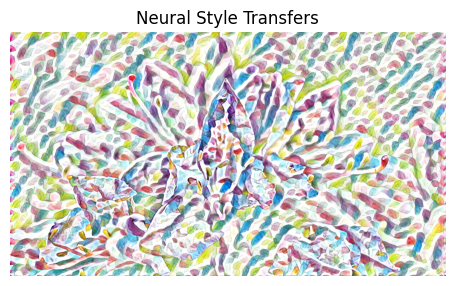

4. Using Model: la_muse


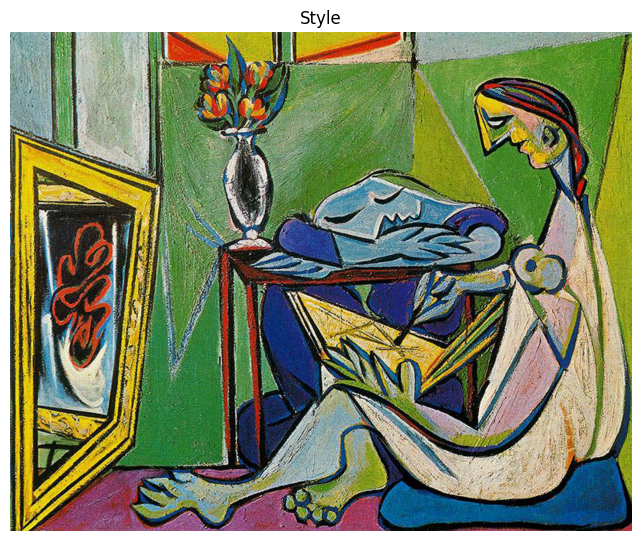

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


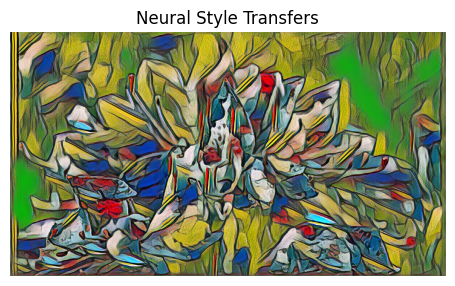

5. Using Model: mosaic


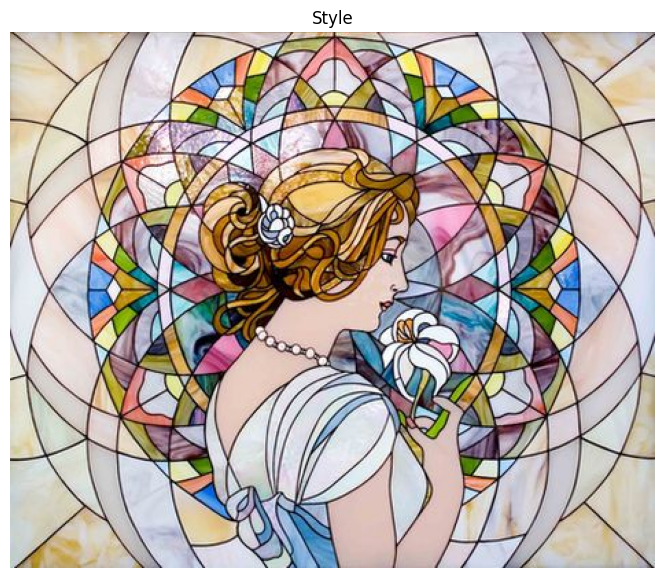

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


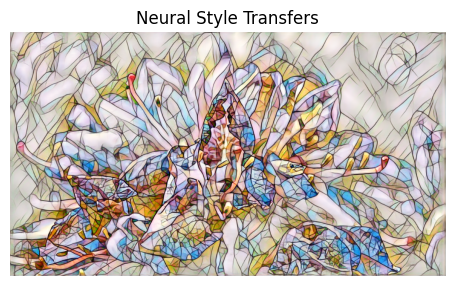

6. Using Model: starry_night


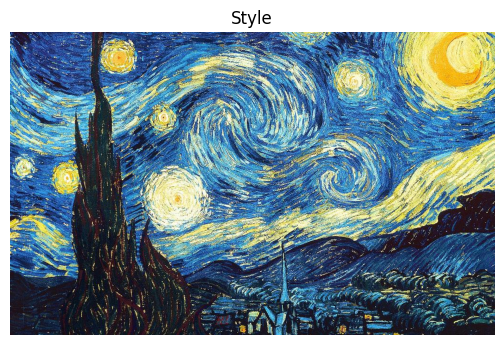

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


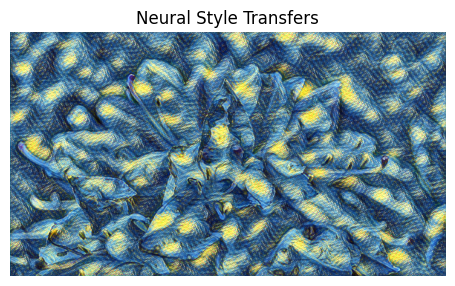

7. Using Model: the_scream


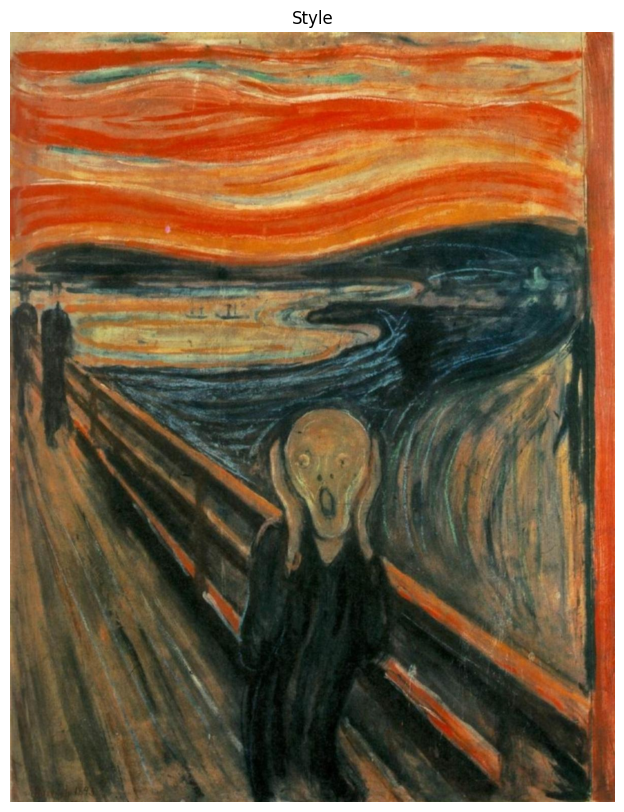

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


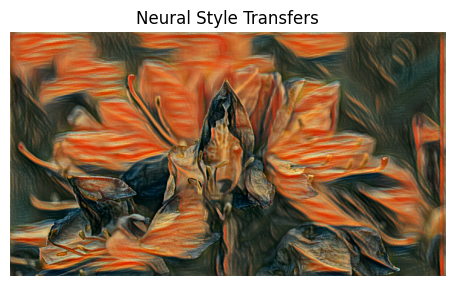

8. Using Model: the_wave


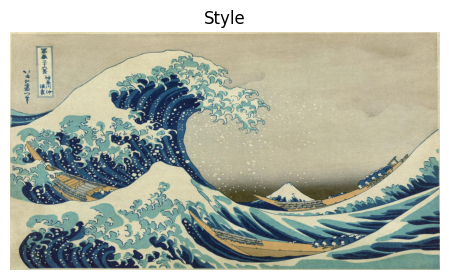

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


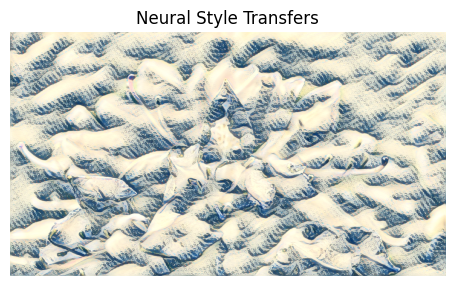

9. Using Model: udnie


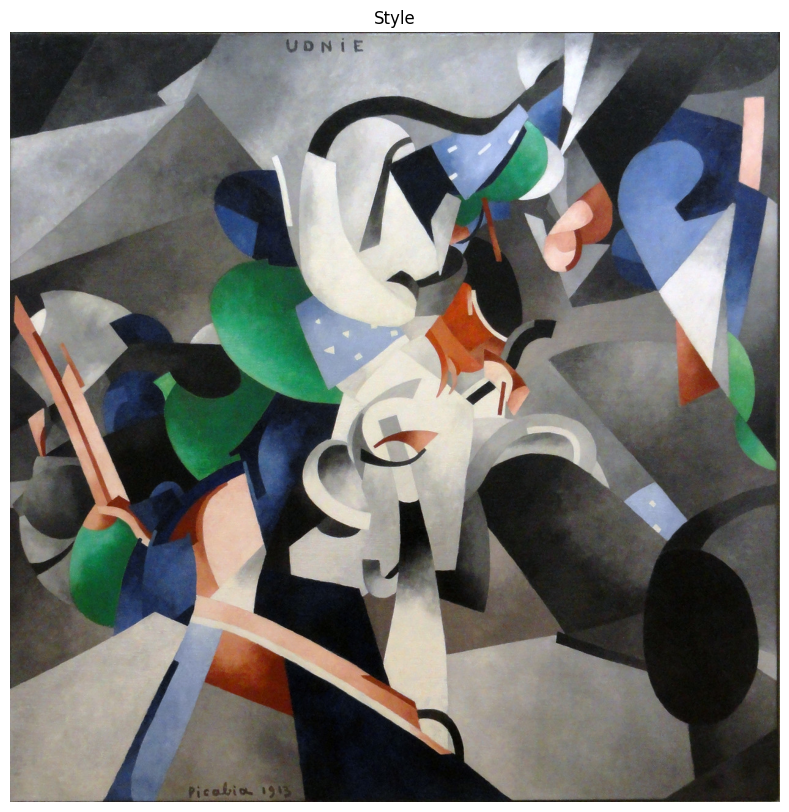

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


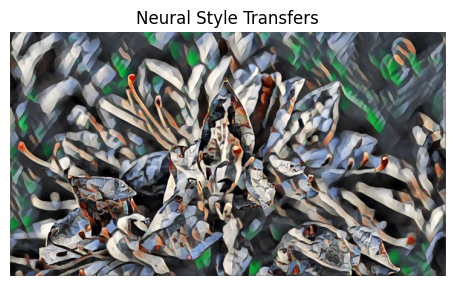

In [62]:
art_transfer(img_2)

---